## RL and Advanced DL: Домашнее задание 3
Третье домашнее задание посвящено порождающим моделям, а точнее — порождающим состязательным сетям. Это самое маленькое и самое техническое задание в курсе, но что уж поделать. Как обычно, в качестве решения ожидается ссылка на jupyter-ноутбук на вашем github (или публичный, или с доступом для snikolenko); ссылку обязательно нужно прислать в виде сданного домашнего задания на портале Академии. Любые комментарии, новые идеи и рассуждения на тему, как всегда, категорически приветствуются.

### Часть первая: перенос стиля при помощи pix2pix
В этом задании мы будем реализовывать перенос стиля на спаренных данных (paired data). Из стандартных датасетов я выбрал самый маленький -- давайте реализуем перенос стиля из масок сегментации в “настоящие фотографии” для конкретного случая фасадов домов:

![IMG](images/img_1.png)

Датасет можно скачать здесь (и во многих других местах, должно быть ~29 мегабайт).
В первой части подразумевается реализация pix2pix архитектуры, т.е. генератора и дискриминатора, которые получают на вход условие в виде изображения исходного стиля (подробнее см. лекцию и собственно Isola et al., 2016):

![IMG](images/img_2.png)

In [1]:
import torch
import torch.nn.functional as F
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torchvision
import numpy as np
from glob import glob
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm

/home/ubuntu/anaconda/envs/ai_ml/lib/python3.6/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


#### Загрузка датасета

In [2]:
class FacadesDataset(Dataset):
    def __init__(self, path):
        self.path = path
        self.images = glob(self.path + '/*.jpg');
        self.transforms = transforms.ToTensor()
        
    def __getitem__(self, idx):
        image = Image.open(self.images[idx]).convert('RGB')
        filename = self.images[idx].split('/')[-1]
        width = image.width
        image_array = np.array(image)
        
        mask_image = image_array[:, width // 2:]
        real_image = image_array[:, :width // 2]
        mask_image = self.transforms(mask_image)
        real_image = self.transforms(real_image)
        
        return mask_image, real_image, filename 
        
    def __len__(self):
        return len(self.images)


train_dataset = FacadesDataset(path='facades/train')
train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=True)

test_dataset = FacadesDataset(path='facades/test')
test_dataloader = DataLoader(test_dataset, batch_size=1, shuffle=False)

#### Визуализация датасета

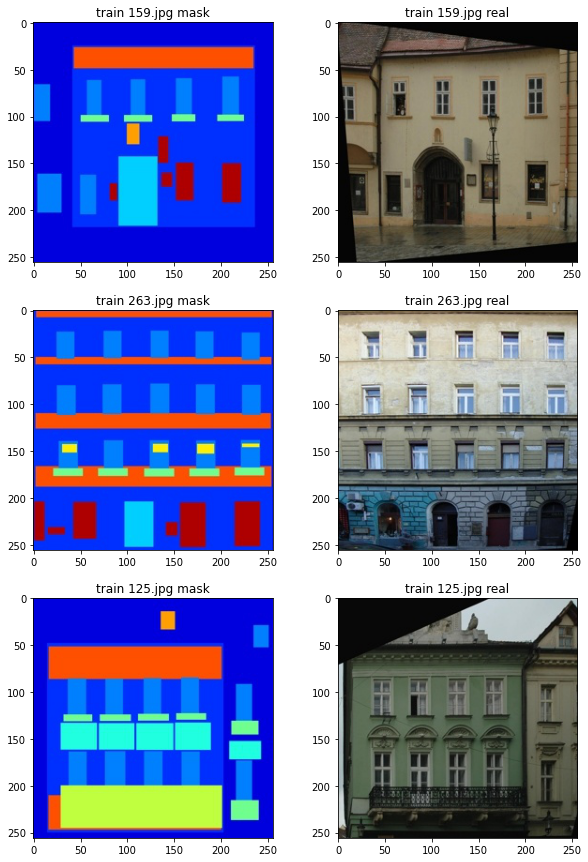

In [3]:
fig, ax = plt.subplots(3, 2, figsize=(10, 15))
for i in range(3):
    ind = np.random.randint(0, len(train_dataset))
    ax[i][0].set_title(f'train {train_dataset[ind][2]} mask')
    ax[i][1].set_title(f'train {train_dataset[ind][2]} real')
    ax[i][0].imshow(train_dataset[ind][0].permute(1, 2, 0))
    ax[i][1].imshow(train_dataset[ind][1].permute(1, 2, 0))

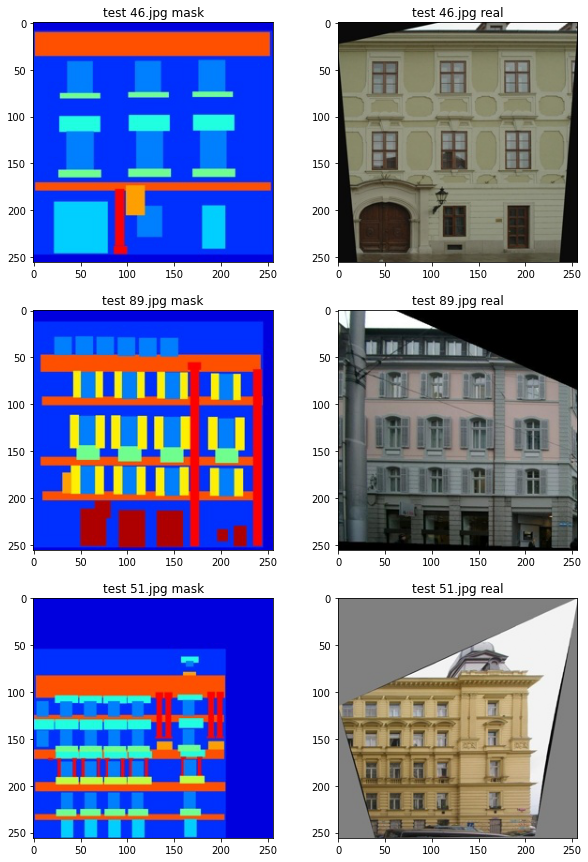

In [4]:
fig, ax = plt.subplots(3, 2, figsize=(10, 15))
for i in range(3):
    ind = np.random.randint(0, len(test_dataset))
    ax[i][0].set_title(f'test {test_dataset[ind][2]} mask')
    ax[i][1].set_title(f'test {test_dataset[ind][2]} real')
    ax[i][0].imshow(test_dataset[ind][0].permute(1, 2, 0))
    ax[i][1].imshow(test_dataset[ind][1].permute(1, 2, 0))

In [5]:
def visualize_for_p2p(mask_images, generated_images, real_images, filenames):
    cnt = len(mask_images)
    num = 3
    fig, ax = plt.subplots(cnt, num, figsize=(15, 5 * cnt), squeeze=False)
    for i in range(cnt):
        ax[i, 0].imshow(mask_images[i].permute(1, 2, 0))
        ax[i, 1].imshow(generated_images[i].permute(1, 2, 0))
        ax[i, 2].imshow(real_images[i].permute(1, 2, 0))
        ax[i, 0].set_title(f'{filenames[i]} mask')
        ax[i, 1].set_title(f'{filenames[i]} generated image')
        ax[i, 2].set_title(f'{filenames[i]} real')
            
    plt.show()

#### Pix2pix

In [6]:
def unet_skip_connection_block(in_channels, out_channels):
    block = nn.Sequential(
        nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, padding=1, bias=False),
        nn.InstanceNorm2d(num_features=out_channels, affine=True), 
        nn.ReLU(inplace=True),
        nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, padding=1, bias=False),
        nn.InstanceNorm2d(num_features=out_channels, affine=True), 
        nn.ReLU(inplace=True),
    )
    return block

In [7]:
class UnetGenerator(nn.Module):
    def __init__(self, in_channels=3, out_channels=64):
        super().__init__()
        self.down_1 = unet_skip_connection_block(in_channels, out_channels)
        self.down_2 = unet_skip_connection_block(out_channels, out_channels * 2)
        self.down_3 = unet_skip_connection_block(out_channels * 2, out_channels * 4)
        self.down_4 = unet_skip_connection_block(out_channels * 4, out_channels * 8)
        self.down_5 = unet_skip_connection_block(out_channels * 8, out_channels * 16)
        
        self.up_1 = unet_skip_connection_block(out_channels * (8 + 16), out_channels * 8)
        self.up_2 = unet_skip_connection_block(out_channels * (4 + 8), out_channels * 4)
        self.up_3 = unet_skip_connection_block(out_channels * (2 + 4), out_channels * 2)
        self.up_4 = unet_skip_connection_block(out_channels * (1 + 2), out_channels)
        self.up_5 = nn.Conv2d(out_channels, in_channels, kernel_size=1)
        
        self.pool = nn.MaxPool2d(kernel_size=2)
        self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        
        
    def forward(self, x):
        out_1 = self.down_1(x)
        out_1 = F.dropout(out_1)
        x = self.pool(out_1)
        
        out_2 = self.down_2(x)
        out_2 = F.dropout(out_2)
        x = self.pool(out_2)
        
        out_3 = self.down_3(x)
        out_3 = F.dropout(out_3)
        x = self.pool(out_3)

        out_4 = self.down_4(x)
        out_4 = F.dropout(out_4)
        x = self.pool(out_4)
        
        x = self.down_5(x)
        
        out_5 = self.up(x)    
        out_5 = torch.cat([out_5, out_4], dim=1)
        x = self.up_1(out_5)
        
        out_6 = self.up(x)        
        out_6 = torch.cat([out_6, out_3], dim=1)
        x = self.up_2(out_6)
        
        out_7 = self.up(x)        
        out_7 = torch.cat([out_7, out_2], dim=1)
        x = self.up_3(out_7)

        out_8 = self.up(x)        
        out_8 = torch.cat([out_8, out_1], dim=1)
        x = self.up_4(out_8)
        
        x = self.up_5(x)
        x = torch.sigmoid(x)
        return x

In [8]:
class Discriminator(nn.Module):
    def __init__(self, in_channels=6, out_channels=64):
        super().__init__()
        self.down_1 = unet_skip_connection_block(in_channels, out_channels)
        self.down_2 = unet_skip_connection_block(out_channels, out_channels * 2)
        self.down_3 = unet_skip_connection_block(out_channels * 2, out_channels * 4)
        self.down_4 = unet_skip_connection_block(out_channels * 4, out_channels * 8)
        self.pool = nn.MaxPool2d(kernel_size=2)
        
        self.pooling = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(out_channels * 8, 2)
        
    def forward(self, condition, x=None):
        x = torch.cat([condition, x], dim=1)
        
        out_1 = self.down_1(x)
        out_1 = self.pool(out_1)
        x = F.dropout(out_1)
        
        out_2 = self.down_2(x)
        out_2 = self.pool(out_2)
        x = F.dropout(out_2)
        
        out_3 = self.down_3(x)
        x = self.pool(out_3)
        
        out_4 = self.down_4(x)
        x = self.pool(out_4) 
        
        x = self.pooling(x)
        x = x.squeeze(-1).squeeze(-1) 
        x = self.fc(x)

        return x

In [9]:
class Pix2Pix:
    def __init__(self):
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
        print(f'device={self.device}')
        self.generator = UnetGenerator().to(self.device)
        self.discriminator = Discriminator().to(self.device)
        self.criterion_l1 = torch.nn.SmoothL1Loss()
        self.criterion_ce = torch.nn.CrossEntropyLoss()
        self.optimizer_generator = torch.optim.Adam(self.generator.parameters(), lr=1e-4)
        self.optimizer_discriminator = torch.optim.Adam(self.discriminator.parameters(), lr=1e-4)

    def train_step(self, batch):
        mask_images, real_images, _ = batch
        mask_images = mask_images.to(self.device)
        real_images = real_images.to(self.device)
        
        self.optimizer_discriminator.zero_grad()
        
        generated_images = self.generator(mask_images)
        
        logits_generated = self.discriminator(mask_images, generated_images)
        logits_real = self.discriminator(mask_images, real_images)
        D_generated_loss = self.criterion_ce(logits_generated, torch.zeros(logits_generated.shape[0]).long().to(self.device))
        D_real_loss = self.criterion_ce(logits_real, torch.ones(logits_generated.shape[0]).long().to(self.device))
        D_loss = (D_generated_loss + D_real_loss) / 2    
        D_loss.backward()
        
        self.optimizer_discriminator.step()

        self.optimizer_generator.zero_grad()
        
        generated_images = self.generator(mask_images)
        
        logits_generated = self.discriminator(real_images, generated_images)
        G_ce = self.criterion_ce(logits_generated, torch.ones(logits_generated.shape[0]).long().to(self.device))
        G_l1 = self.criterion_l1(generated_images, real_images)
        G_loss = G_ce + 100 * G_l1
        G_loss.backward()
        
        self.optimizer_generator.step()
        
        return D_loss.item(), G_loss.item()

    def generate_image(self, batch):
        with torch.no_grad():
            generation = self.generator(batch.to(self.device))
        return generation.cpu()


device=cuda
epoch 0: D_loss 0.4863349199295044| G_loss 2.9045281410217285


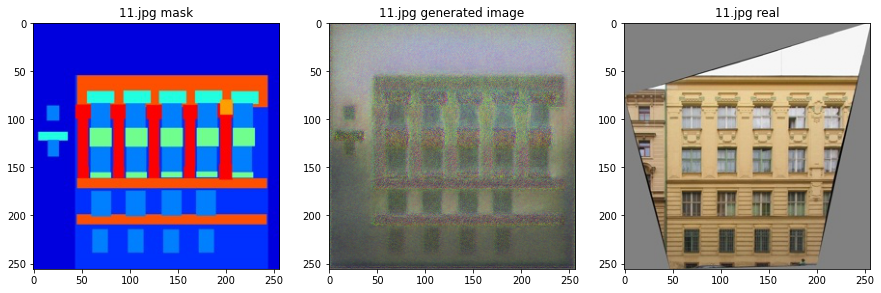

epoch 10: D_loss 0.02355276606976986| G_loss 2.124069929122925


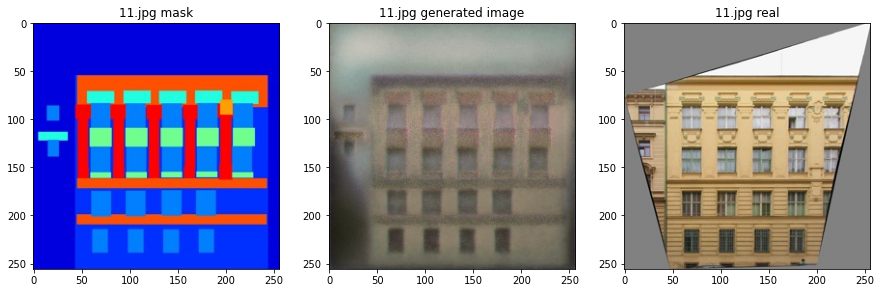

epoch 20: D_loss 0.10841577500104904| G_loss 1.9786436557769775


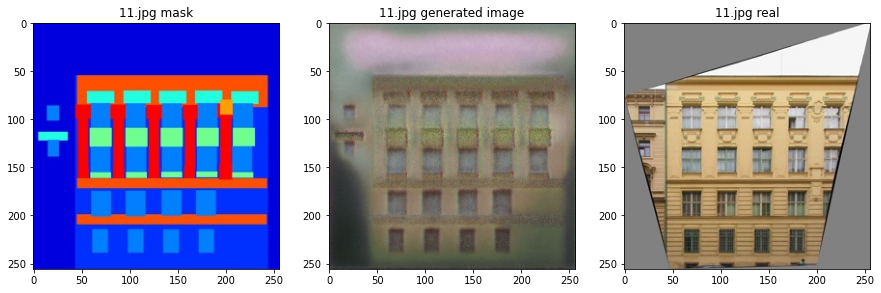

epoch 30: D_loss 0.004791313782334328| G_loss 1.5716029405593872


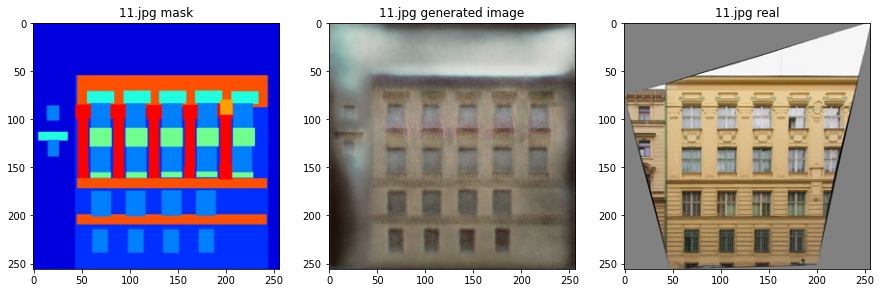

epoch 40: D_loss 0.0025471956469118595| G_loss 1.0967352390289307


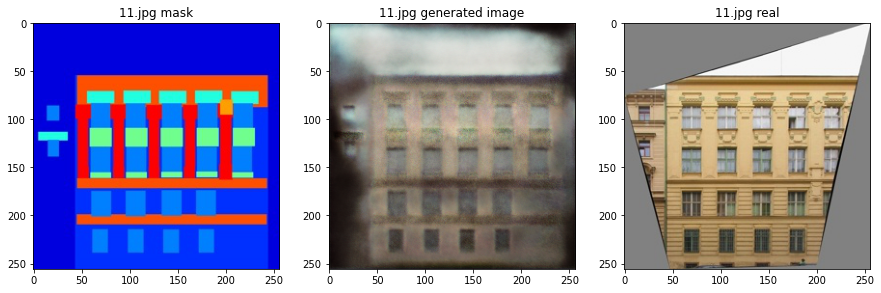

epoch 50: D_loss 0.0033901885617524385| G_loss 0.9163320660591125


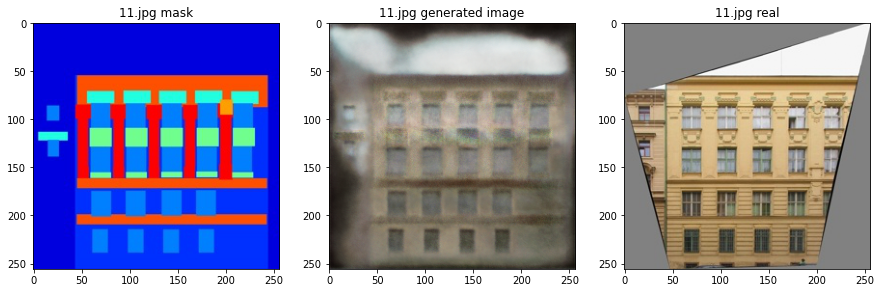

epoch 60: D_loss 0.007005889900028706| G_loss 1.193526268005371


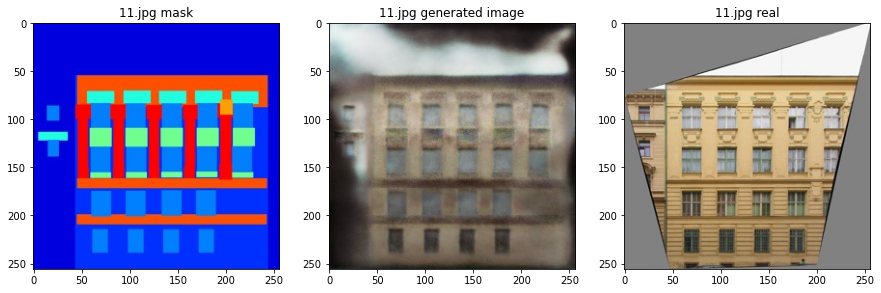

epoch 70: D_loss 0.0017882371321320534| G_loss 0.842347264289856


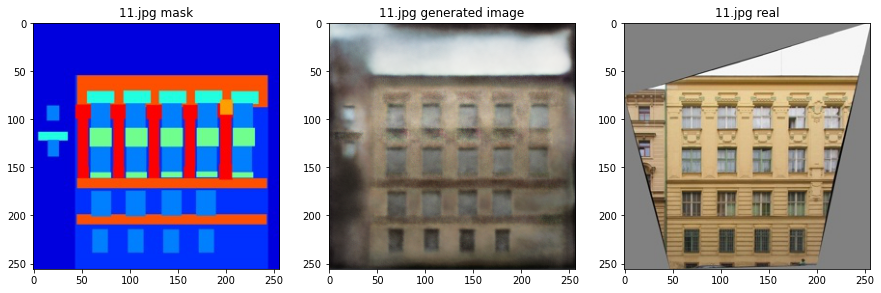

epoch 80: D_loss 0.001219366560690105| G_loss 0.7859408855438232


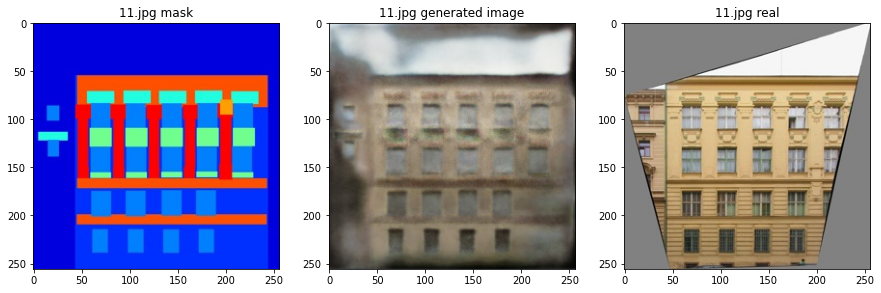

epoch 90: D_loss 0.001397338812239468| G_loss 0.9437795281410217


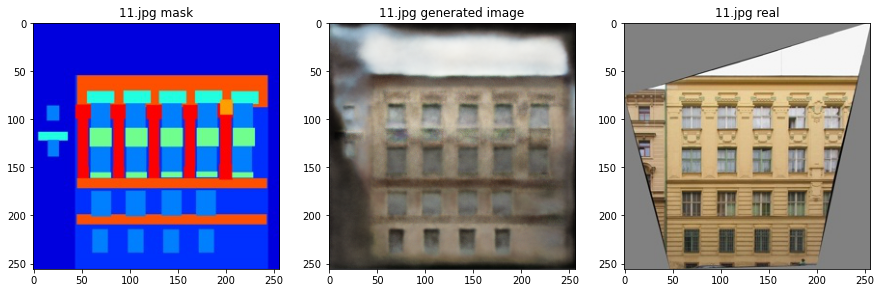

CPU times: user 1h 10min 6s, sys: 10min, total: 1h 20min 7s
Wall time: 47min 39s


In [10]:
%%time
pix2pix = Pix2Pix()

for epoch in range(100):
    pix2pix.generator.train()
    pix2pix.discriminator.train()
    for i, batch in enumerate(train_dataloader):
        discriminator_loss, generator_loss = pix2pix.train_step(batch)
    
    if epoch % 10 == 0:
        print(f'epoch {epoch}: D_loss {discriminator_loss}| G_loss {generator_loss}')
        # визуально оцениваем на одной картинке, чтобы видеть динамику
        pix2pix.generator.eval()
        for mask_images, real_images, test_filenames in test_dataloader:
            generated_images = pix2pix.generate_image(mask_images)
            visualize_for_p2p(mask_images, generated_images, real_images, test_filenames)
            break

#### Результат на тестовой выборке

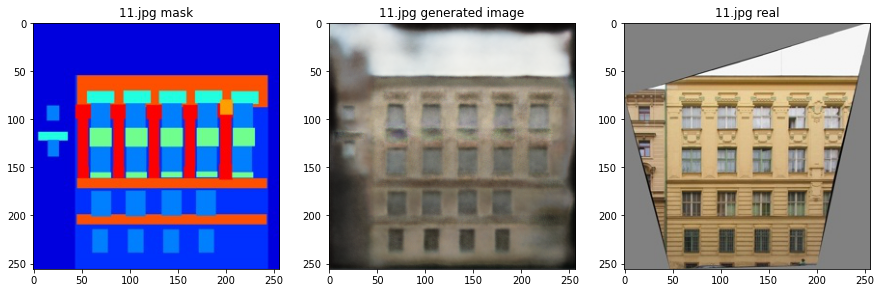

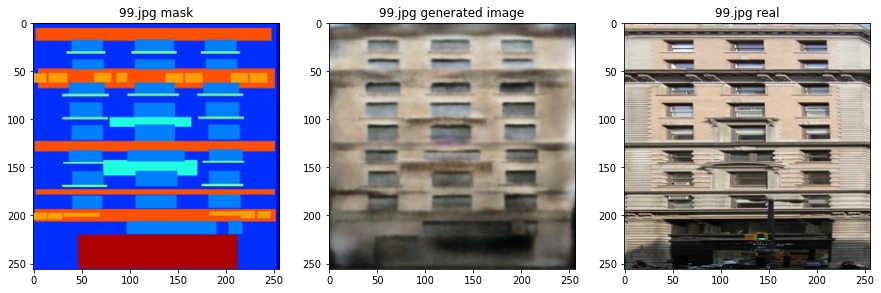

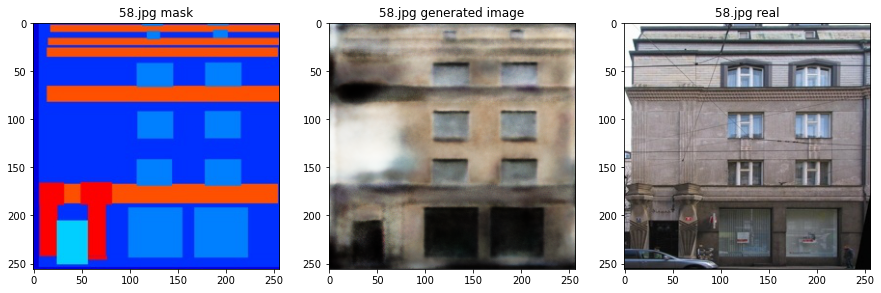

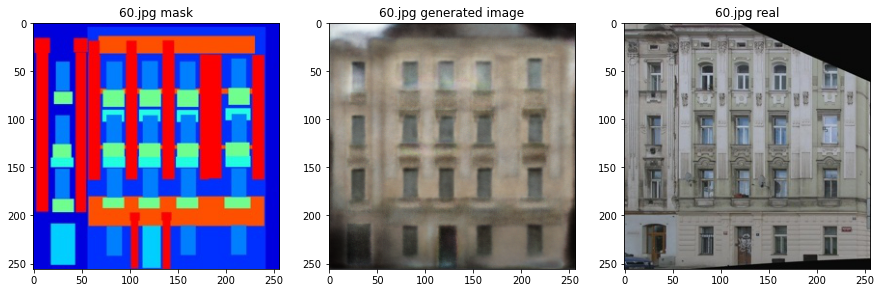

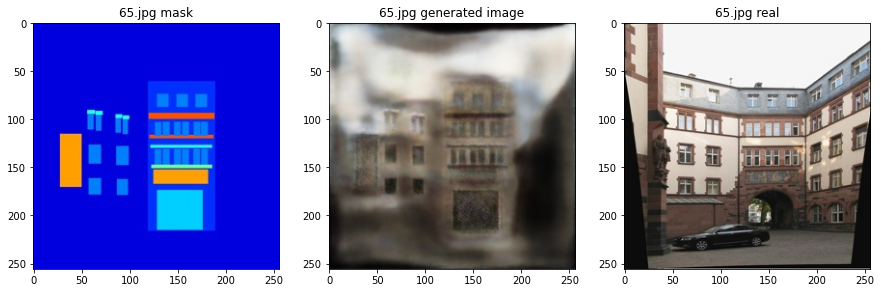

...

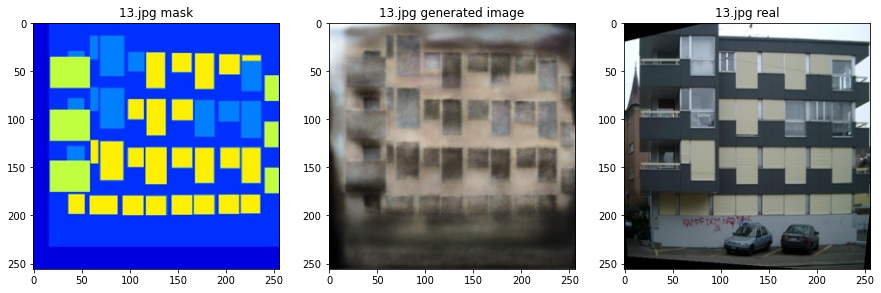

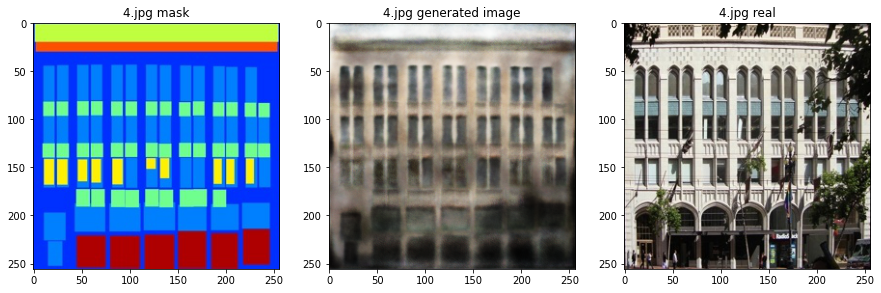

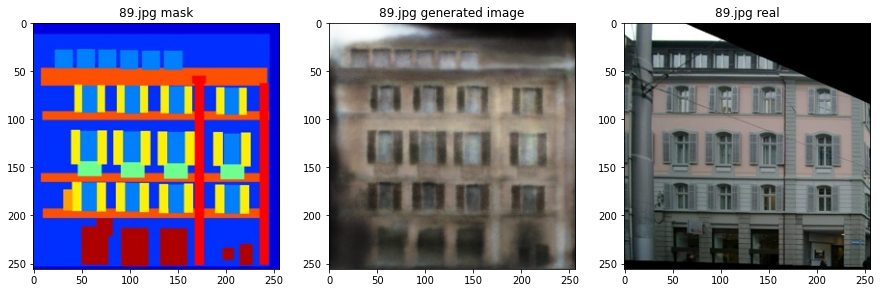

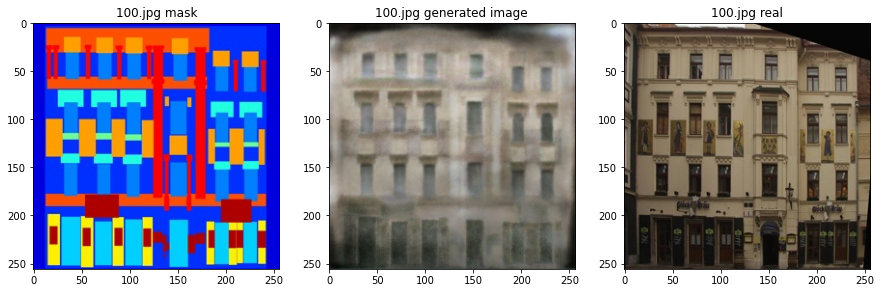

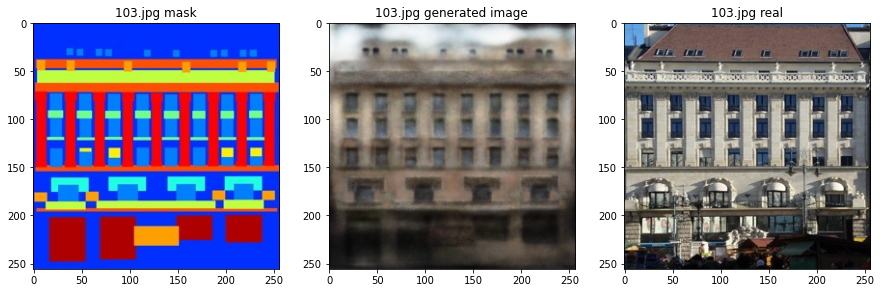

In [11]:
pix2pix.generator.eval()
cnt = 0
for mask_images, real_images, test_filenames in test_dataloader:
    cnt += 1
    generated_images = pix2pix.generate_image(mask_images)
    visualize_for_p2p(mask_images, generated_images, real_images, test_filenames)
    if cnt > 20:
        break

### Часть вторая: добавим циклы
Вторая часть -- реализация CycleGAN. Предлагается на том же датасете реализовать базовую конструкцию CycleGAN для unpaired style transfer, то есть переноса стилей, каждый из которых задан неразмеченным датасетом (подробнее см. лекцию и собственно Zhu et al., 2017):

![IMG](images/img_3.png)

В качестве опционального задания за немного дополнительных баллов здесь предлагаю найти дополнительные данные такого рода (фасады и их карты сегментации) и улучшить качество переноса стиля за счёт обучения на датасете побольше. Данные, скорее всего, будут unpaired, поэтому эта часть скорее релевантна CycleGAN.

#### Загрузка датасета

In [12]:
class FacadesDataset(Dataset):
    def __init__(self, path):
        self.path = path
        self.images = glob(self.path + '/*.jpg');
        self.transforms = transforms.ToTensor()
        
    def __getitem__(self, idx):
        image = Image.open(self.images[idx]).convert('RGB')
        mask_filename = self.images[idx].split('/')[-1]
        width = image.width
        image_array = np.array(image)
        mask_image = image_array[:, width // 2:]
        real_image_for_mask = image_array[:, :width // 2] # это нам нужно исключительно для визуализации результата
        
        # здесь данные должны быть неспаренные, поэтому вторую часть возьмем рандомно
        path = np.random.choice(self.images)
        image = Image.open(path).convert('RGB')
        real_filename = path.split('/')[-1]
        width = image.width
        image_array = np.array(image)
        real_image = image_array[:, :width // 2]
        mask_image_for_real = image_array[:, width // 2:]  # это нам нужно исключительно для визуализации результата
        
        mask_image = self.transforms(mask_image)
        real_image = self.transforms(real_image)

        real_image_for_mask = self.transforms(real_image_for_mask)  # это нам нужно исключительно для визуализации результата
        mask_image_for_real = self.transforms(mask_image_for_real)  # это нам нужно исключительно для визуализации результата
        
        return mask_image, real_image, mask_filename, real_filename, real_image_for_mask, mask_image_for_real
        
    def __len__(self):
        return len(self.images)


train_dataset = FacadesDataset(path='facades/train')
train_dataloader = DataLoader(train_dataset, batch_size=5, shuffle=True)

test_dataset = FacadesDataset(path='facades/test')
test_dataloader = DataLoader(test_dataset, batch_size=1, shuffle=False)

#### Визуализация датасета (неспаренные данные: маска и картинка из разных изображений)

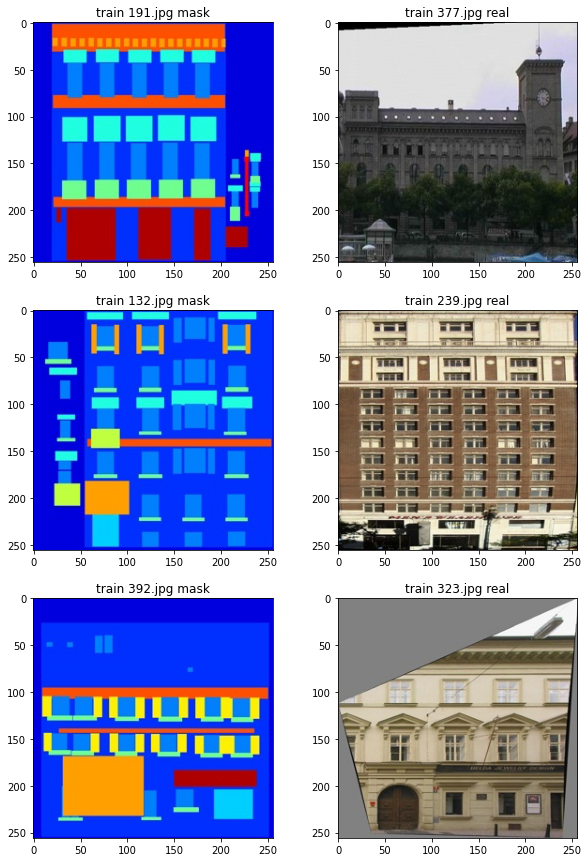

In [13]:
fig, ax = plt.subplots(3, 2, figsize=(10, 15))
for i in range(3):
    ind = np.random.randint(0, len(train_dataset))
    ax[i][0].set_title(f'train {train_dataset[ind][2]} mask')
    ax[i][1].set_title(f'train {train_dataset[ind][3]} real')
    ax[i][0].imshow(train_dataset[ind][0].permute(1, 2, 0))
    ax[i][1].imshow(train_dataset[ind][1].permute(1, 2, 0))

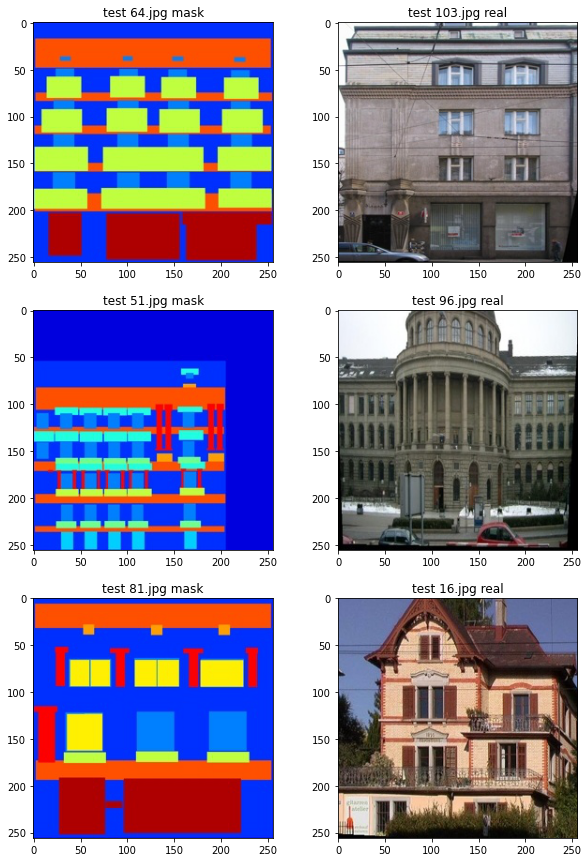

In [14]:
fig, ax = plt.subplots(3, 2, figsize=(10, 15))
for i in range(3):
    ind = np.random.randint(0, len(test_dataset))
    ax[i][0].set_title(f'test {test_dataset[ind][2]} mask')
    ax[i][1].set_title(f'test {test_dataset[ind][3]} real')
    ax[i][0].imshow(test_dataset[ind][0].permute(1, 2, 0))
    ax[i][1].imshow(test_dataset[ind][1].permute(1, 2, 0))

In [15]:
def visualize_for_cg(mask_images, generated_images, real_images, generated_masks, mask_filenames, real_filenames, real_images_for_masks, mask_images_for_reals):
    cnt = len(mask_images)
    num = 3
    fig, ax = plt.subplots(2*cnt, num, figsize=(15, 10 * cnt), squeeze=False)
    for i in range(0,2*cnt,2):
        ax[i, 0].imshow(mask_images[i//2].permute(1, 2, 0))
        ax[i, 1].imshow(generated_images[i//2].permute(1, 2, 0))
        ax[i, 2].imshow(real_images_for_masks[i//2].permute(1, 2, 0))
        ax[i, 0].set_title(f'{mask_filenames[i//2]} mask')
        ax[i, 1].set_title(f'{mask_filenames[i//2]} generated image')
        ax[i, 2].set_title(f'{mask_filenames[i//2]} real')

        ax[i+1, 0].imshow(real_images[i//2].permute(1, 2, 0))
        ax[i+1, 1].imshow(generated_masks[i//2].permute(1, 2, 0))
        ax[i+1, 2].imshow(mask_images_for_reals[i//2].permute(1, 2, 0))
        ax[i+1, 0].set_title(f'{real_filenames[i//2]} real')
        ax[i+1, 1].set_title(f'{real_filenames[i//2]} generated mask')
        ax[i+1, 2].set_title(f'{real_filenames[i//2]} mask')
            
    plt.show()

#### CycleGAN

In [16]:
class CycleDiscriminator(nn.Module):
    def __init__(self, in_channels=3, out_channels=64):
        super().__init__()
        self.down_1 = unet_skip_connection_block(in_channels, out_channels)
        self.down_2 = unet_skip_connection_block(out_channels, out_channels * 2)
        self.down_3 = unet_skip_connection_block(out_channels * 2, out_channels * 4)
        self.down_4 = unet_skip_connection_block(out_channels * 4, out_channels * 8)
        self.pool = nn.MaxPool2d(kernel_size=2)
        
        self.pooling = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(out_channels * 8, 2)
        
    def forward(self, condition):
        x = condition
        
        out_1 = self.down_1(x)
        out_1 = self.pool(out_1)
        x = F.dropout(out_1)
        
        out_2 = self.down_2(x)
        out_2 = self.pool(out_2)
        x = F.dropout(out_2)
        
        out_3 = self.down_3(x)
        x = self.pool(out_3)
        
        out_4 = self.down_4(x)
        x = self.pool(out_4) 
        
        x = self.pooling(x)
        x = x.squeeze(-1).squeeze(-1) 
        x = self.fc(x)

        return x

In [19]:
class CycleGan:
    def __init__(self):
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
        print(f'device={self.device}')
        self.generator_1 = UnetGenerator().to(self.device)
        self.generator_2 = UnetGenerator().to(self.device)
        self.discriminator_1 = CycleDiscriminator().to(self.device)
        self.discriminator_2 = CycleDiscriminator().to(self.device)
        self.optimizer_g = torch.optim.Adam(list(self.generator_1.parameters()) + list(self.generator_2.parameters()), lr=1e-4)
        self.optimizer_d1 = torch.optim.Adam(self.discriminator_1.parameters(), lr=1e-4)
        self.optimizer_d2 = torch.optim.Adam(self.discriminator_2.parameters(), lr=1e-4)
        self.criterion_l1 = torch.nn.SmoothL1Loss()
        self.criterion_ce = torch.nn.CrossEntropyLoss()

    def train_step(self, batch):
        mask_images, real_images, _, _, _, _ = batch
        mask_images = mask_images.to(self.device)
        real_images = real_images.to(self.device)

        self.optimizer_d1.zero_grad()
        self.optimizer_d2.zero_grad()

        generated_images = self.generator_1(mask_images)
        generated_masks = self.generator_2(real_images)
        logits_generated_masks = self.discriminator_1(generated_masks)
        logits_mask_images = self.discriminator_1(mask_images)
        logits_generated_images = self.discriminator_2(generated_images)
        logits_real_images = self.discriminator_2(real_images)

        D_1_generated_loss = self.criterion_ce(logits_generated_masks, torch.zeros(logits_generated_masks.shape[0]).long().to(self.device))
        D_1_real_loss = self.criterion_ce(logits_mask_images, torch.ones(logits_mask_images.shape[0]).long().to(self.device))
        D_1_loss = (D_1_generated_loss + D_1_real_loss) / 2
        D_1_loss.backward()

        D_2_generated_loss = self.criterion_ce(logits_generated_images, torch.zeros(logits_generated_images.shape[0]).long().to(self.device))
        D_2_real_loss = self.criterion_ce(logits_real_images, torch.ones(logits_real_images.shape[0]).long().to(self.device))
        D_2_loss = (D_2_generated_loss + D_2_real_loss) / 2
        D_2_loss.backward()
        
        self.optimizer_d1.step()
        self.optimizer_d2.step()

        self.optimizer_g.zero_grad()

        generated_images = self.generator_1(mask_images)
        generated_masks = self.generator_2(real_images)
        generated_images_cycle = self.generator_1(generated_masks)
        generated_masks_cycle = self.generator_2(generated_images)
        G_1_l1 = (self.criterion_l1(mask_images, generated_masks_cycle) + self.criterion_l1(real_images, generated_images_cycle)) / 2
        G_2_l1 = (self.criterion_l1(mask_images, generated_masks) + self.criterion_l1(real_images, generated_images)) / 2
        logits_generated_masks = self.discriminator_1(generated_masks)
        logits_generated_images = self.discriminator_2(generated_images)
        G_1_ce = self.criterion_ce(logits_generated_images, torch.ones(logits_generated_images.shape[0]).long().to(self.device))
        G_2_ce = self.criterion_ce(logits_generated_masks, torch.ones(logits_generated_masks.shape[0]).long().to(self.device))
        
        G_1_loss = 50 * G_1_l1 + G_1_ce
        G_2_loss = 50 * G_2_l1 + G_2_ce

        G_loss = G_1_loss + G_2_loss
        G_loss.backward()
        self.optimizer_g.step()
        
        return D_1_loss.item(), D_2_loss.item(), G_loss.item()
    
    def generate_image(self, batch):
        with torch.no_grad():
            pred = self.generator_1(batch.to(self.device))
        return pred.cpu()

    def generate_mask(self, batch):
        with torch.no_grad():
            pred = self.generator_2(batch.to(self.device))
        return pred.cpu()

device=cuda
epoch 0: D_1_loss 0.2014082372188568 | D_2_loss 0.45821332931518555 | G_loss 8.180634498596191


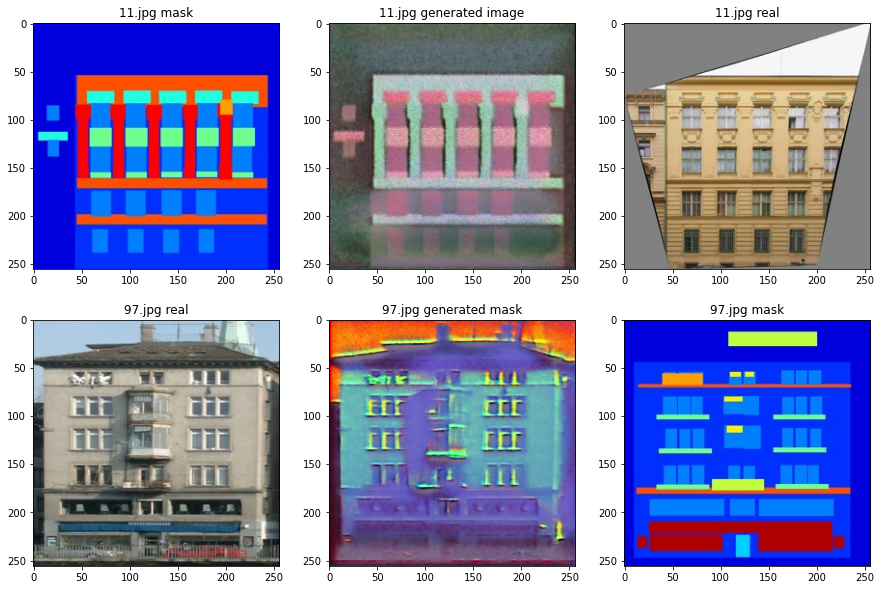

epoch 10: D_1_loss 0.19051118195056915 | D_2_loss 0.4209381341934204 | G_loss 8.271522521972656


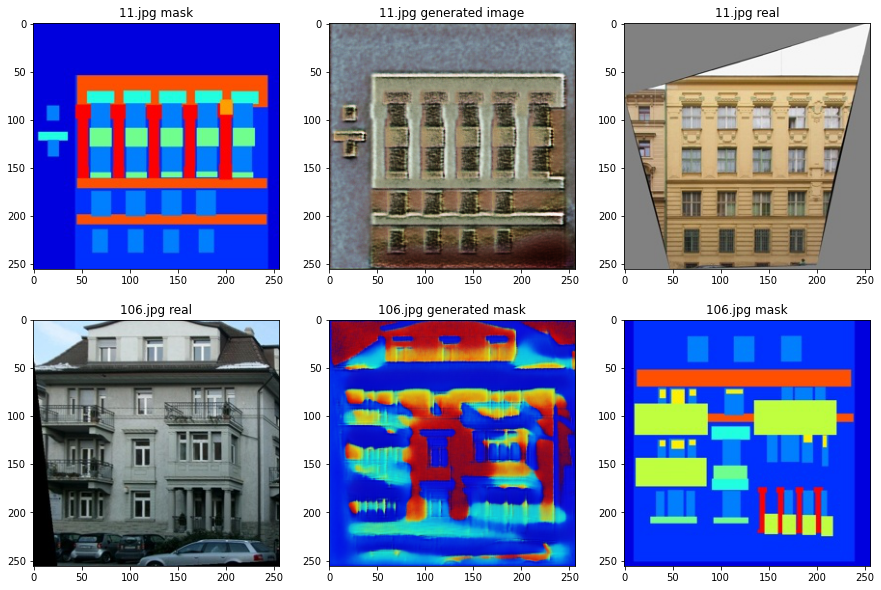

epoch 20: D_1_loss 0.14043402671813965 | D_2_loss 0.3062845766544342 | G_loss 9.207380294799805


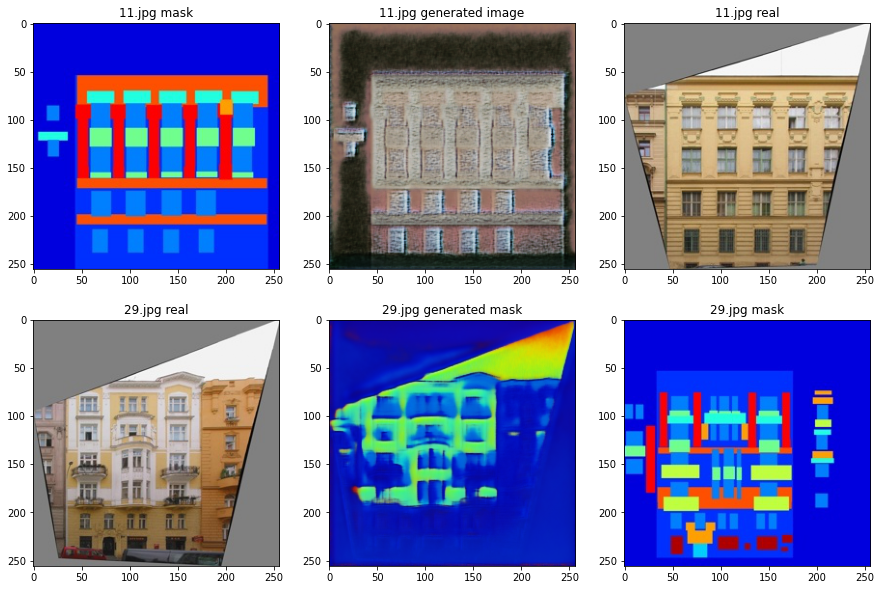

epoch 30: D_1_loss 0.07340104132890701 | D_2_loss 0.1725057065486908 | G_loss 11.989456176757812


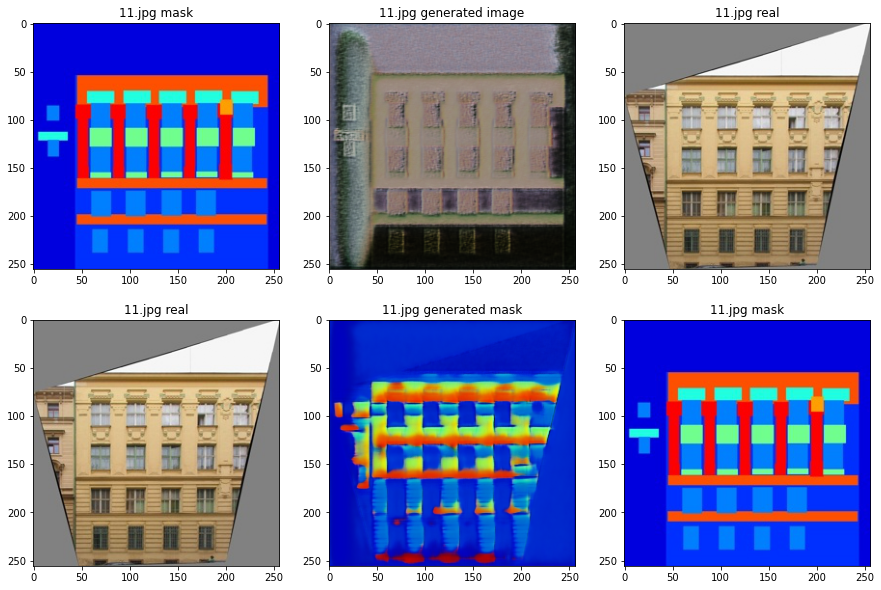

epoch 40: D_1_loss 0.08747567236423492 | D_2_loss 0.24355748295783997 | G_loss 9.454233169555664


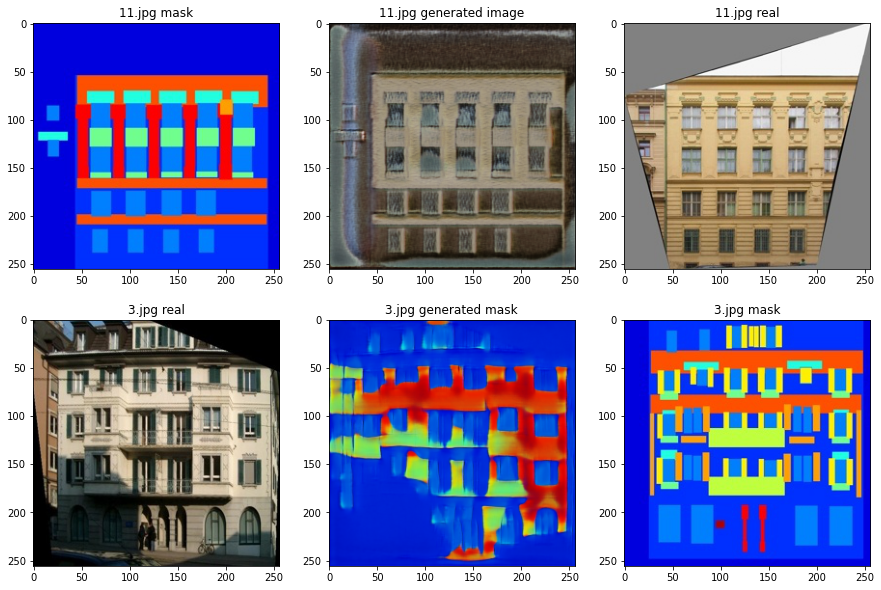

epoch 50: D_1_loss 0.01833449676632881 | D_2_loss 0.426322877407074 | G_loss 11.983654022216797


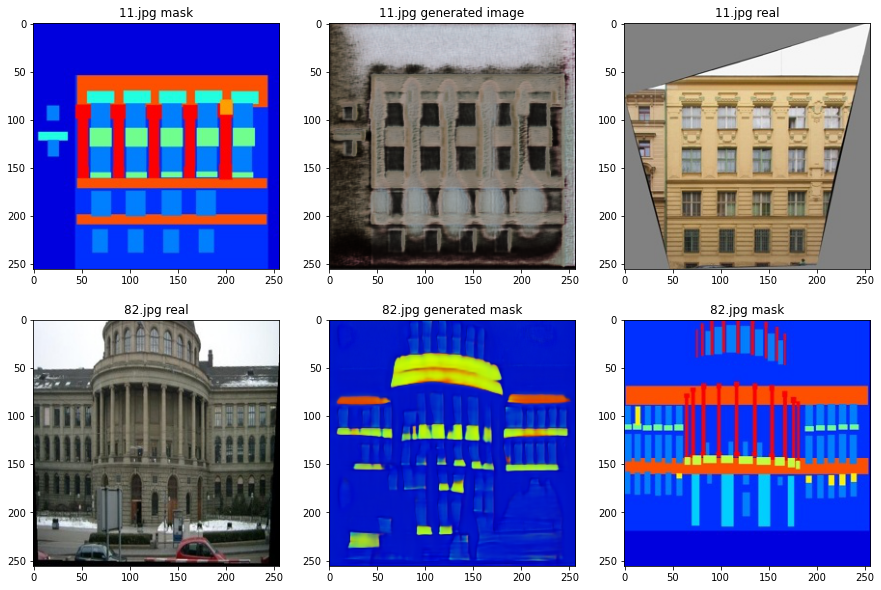

epoch 60: D_1_loss 0.036696985363960266 | D_2_loss 0.37994688749313354 | G_loss 10.855806350708008


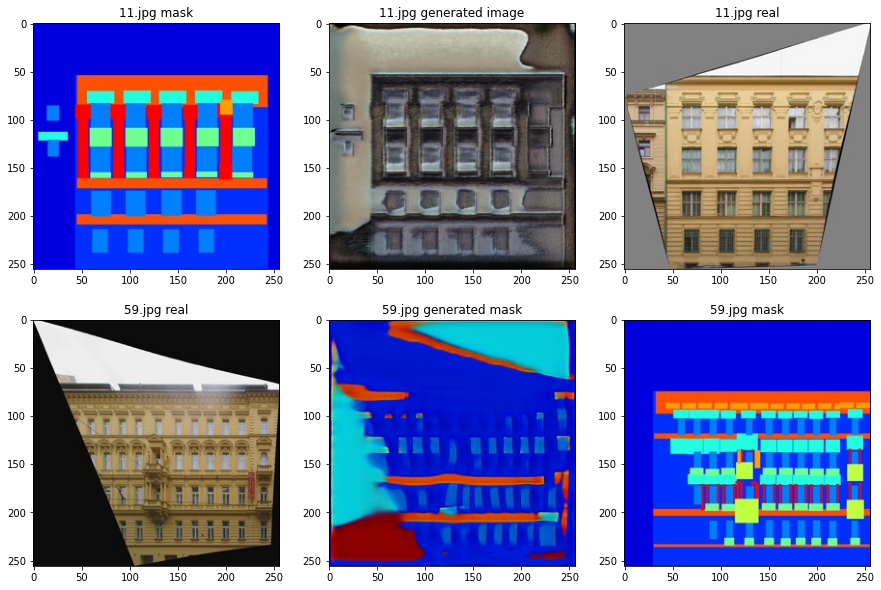

epoch 70: D_1_loss 0.02328365482389927 | D_2_loss 0.08025979995727539 | G_loss 13.788551330566406


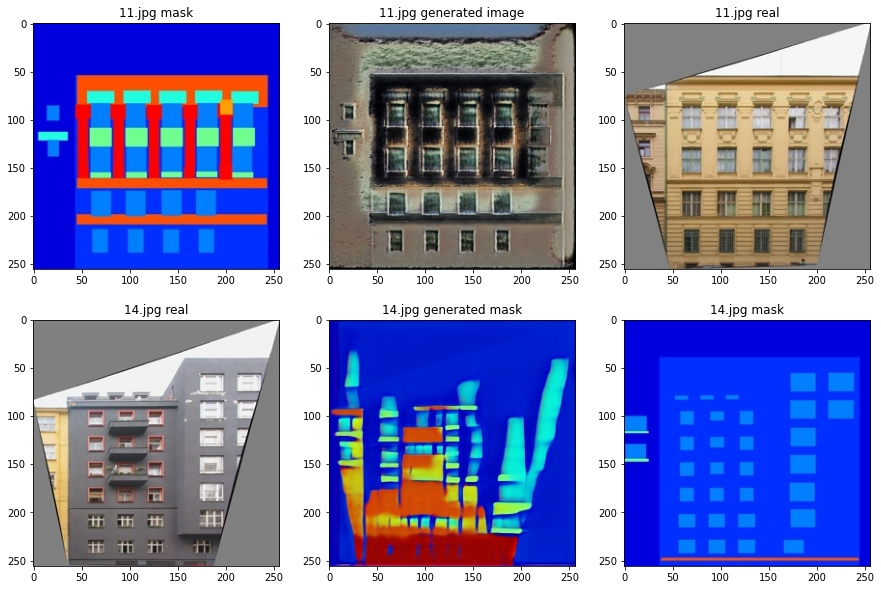

epoch 80: D_1_loss 0.004803856834769249 | D_2_loss 0.043910007923841476 | G_loss 17.800514221191406


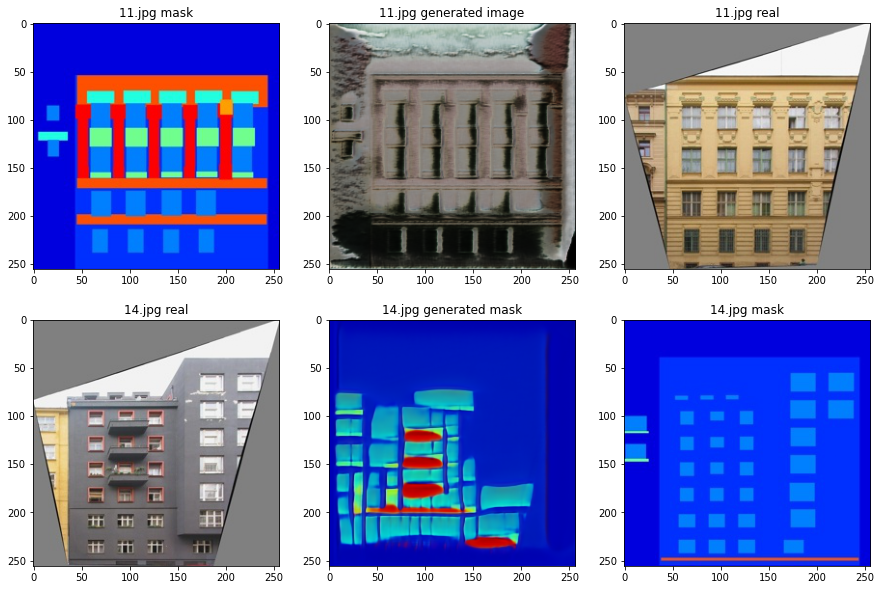

epoch 90: D_1_loss 0.0027891979552805424 | D_2_loss 0.4759018123149872 | G_loss 15.179444313049316


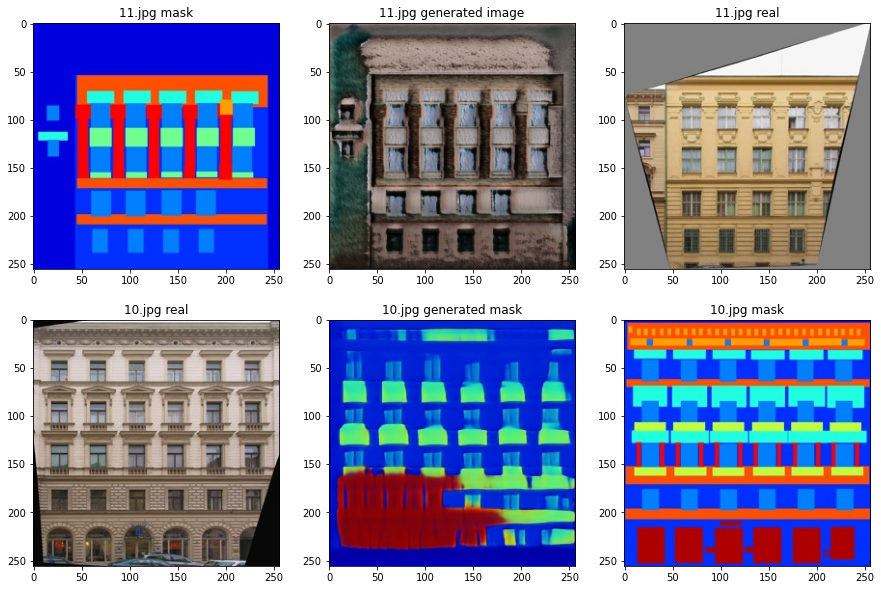

CPU times: user 2h 26min 11s, sys: 25min 1s, total: 2h 51min 13s
Wall time: 2h 13min 53s


In [20]:
%%time
cycle_gan = CycleGan()

for epoch in range(100):
    cycle_gan.generator_1.train()
    cycle_gan.discriminator_1.train()
    cycle_gan.generator_2.train()
    cycle_gan.discriminator_2.train()
    for i, batch in enumerate(train_dataloader):
        discriminator_1_loss, discriminator_2_loss, generator_loss = cycle_gan.train_step(batch)
    
    if epoch % 10 == 0:
        print(f'epoch {epoch}: D_1_loss {discriminator_1_loss} | D_2_loss {discriminator_2_loss} | G_loss {generator_loss}')
        cycle_gan.generator_1.eval()
        cycle_gan.generator_2.eval()
        for mask_images, real_images, mask_filenames, real_filenames, real_images_for_masks, mask_images_for_reals in test_dataloader:
            generated_images = cycle_gan.generate_image(mask_images)
            generated_masks = cycle_gan.generate_mask(real_images)
            visualize_for_cg(mask_images, generated_images, real_images, generated_masks, mask_filenames, real_filenames, real_images_for_masks, mask_images_for_reals)
            break

#### Результат на тестовой выборке

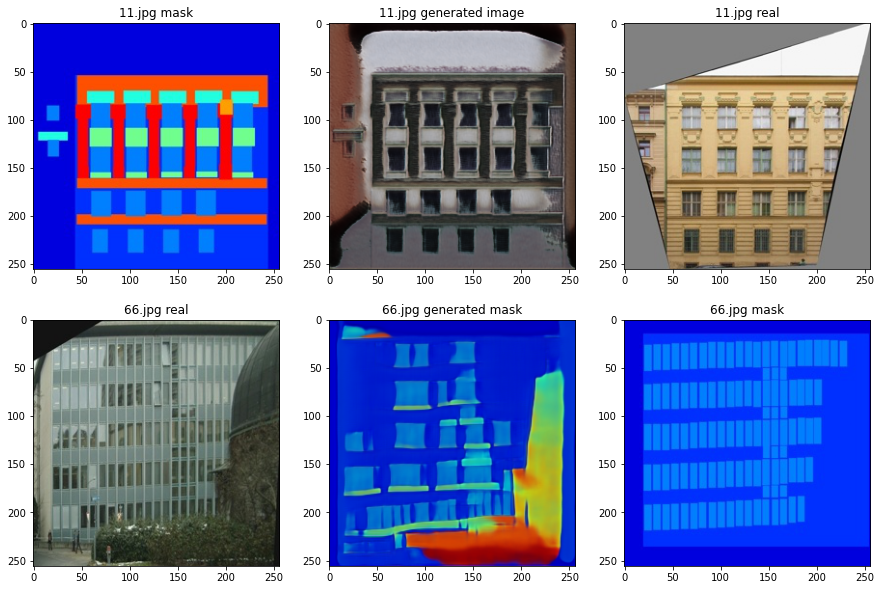

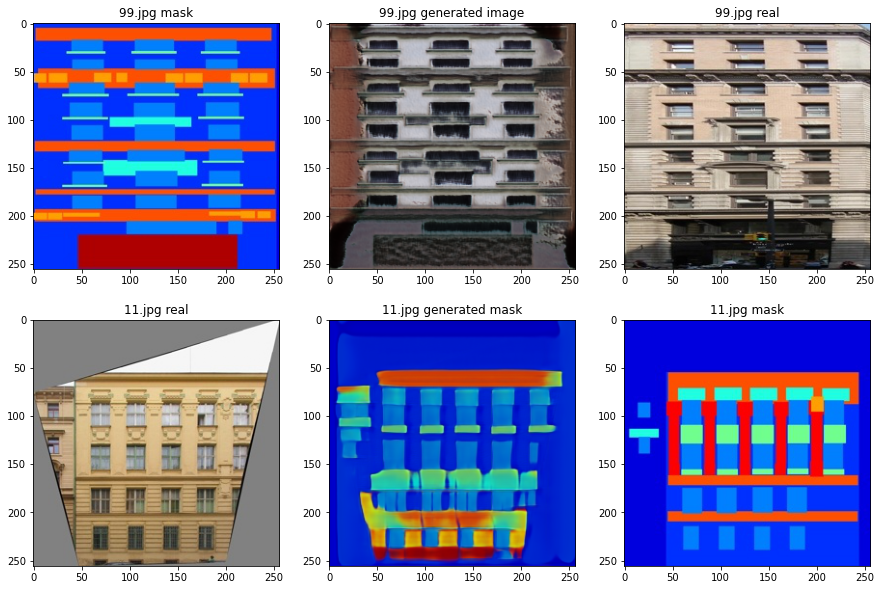

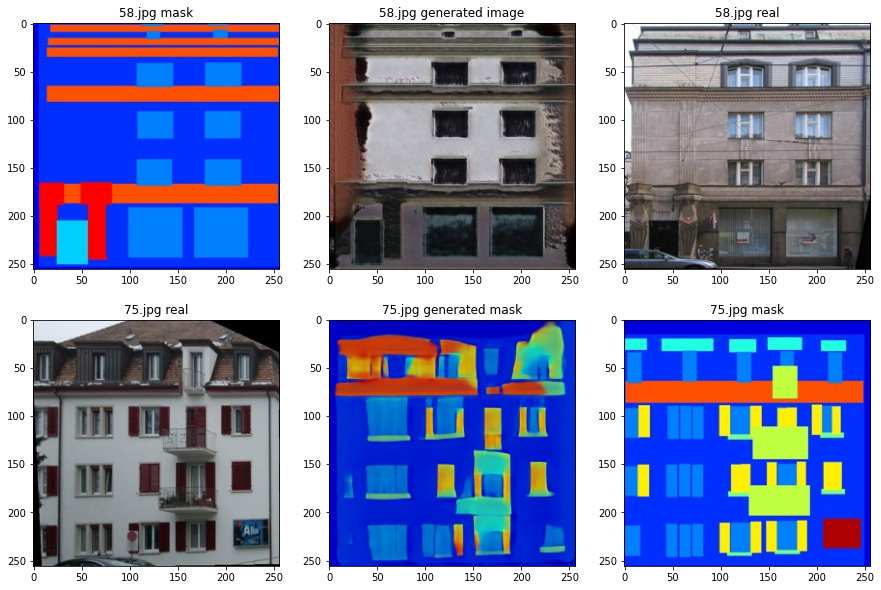

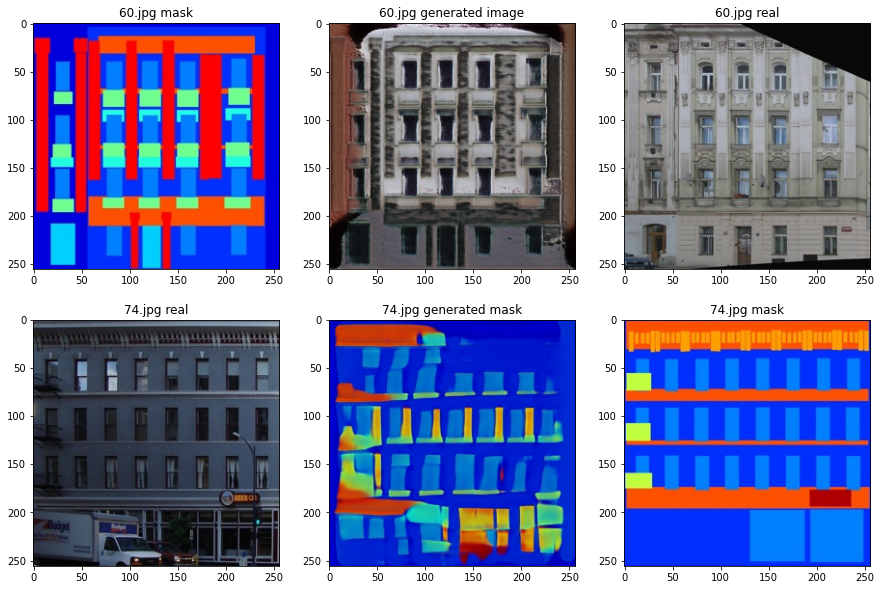

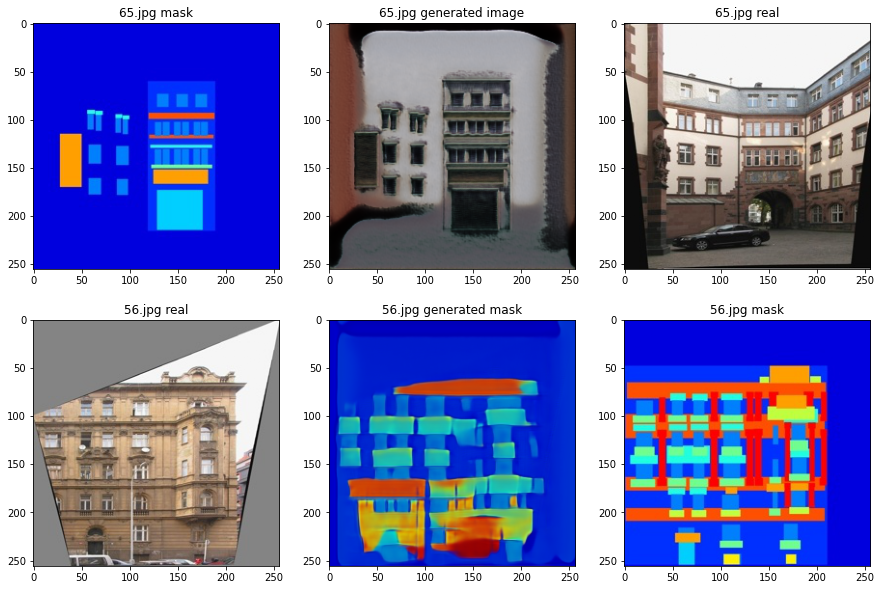

...

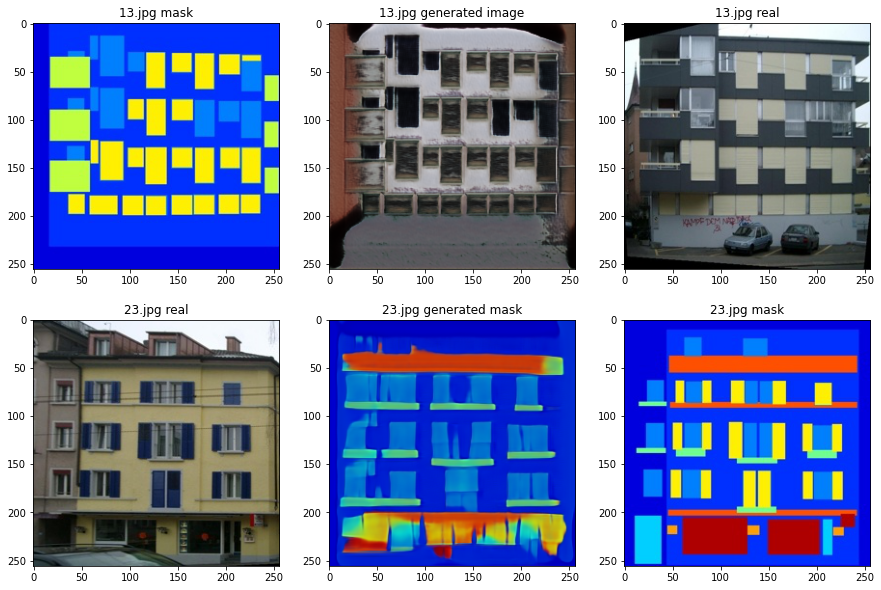

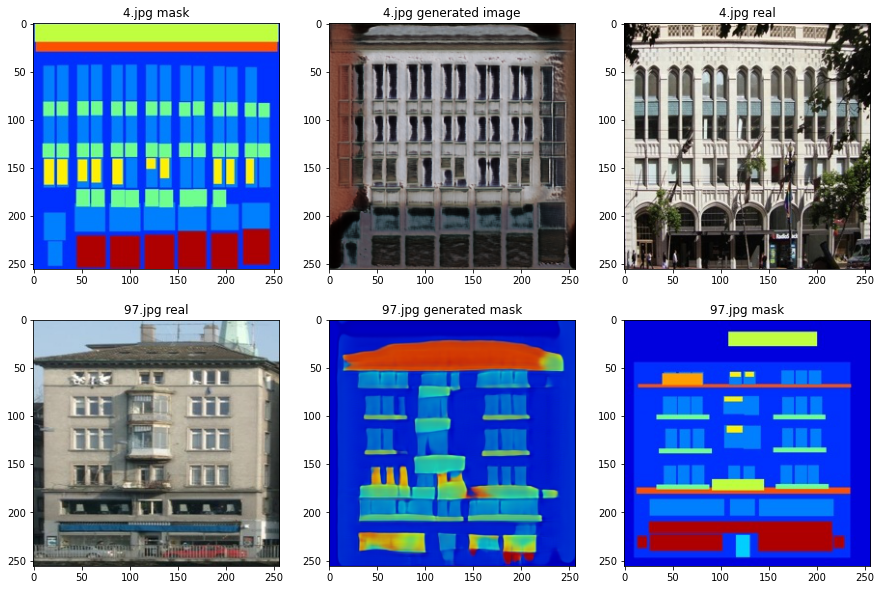

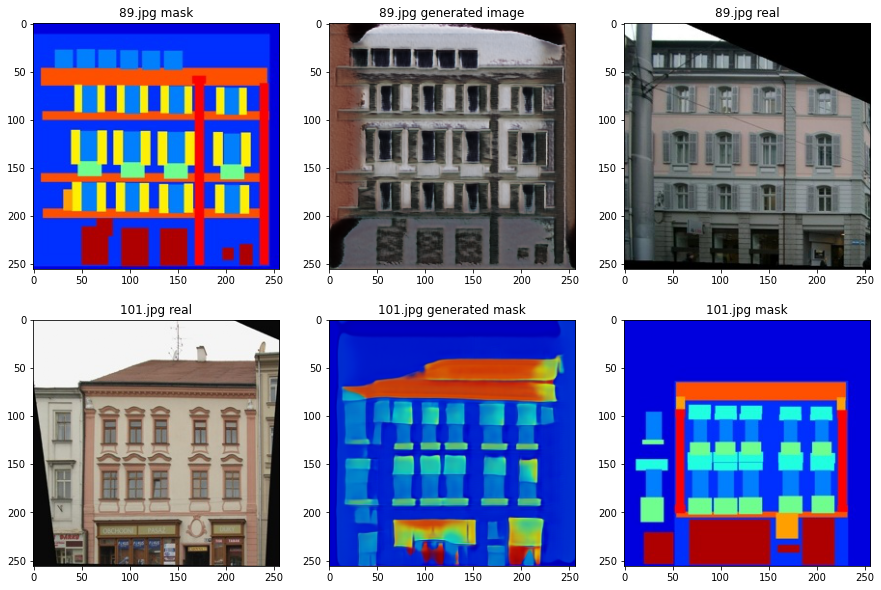

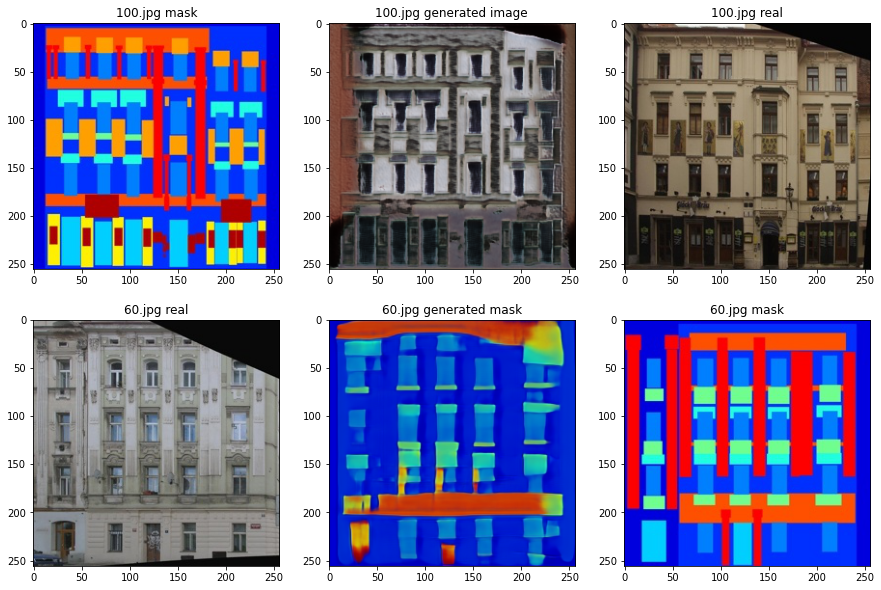

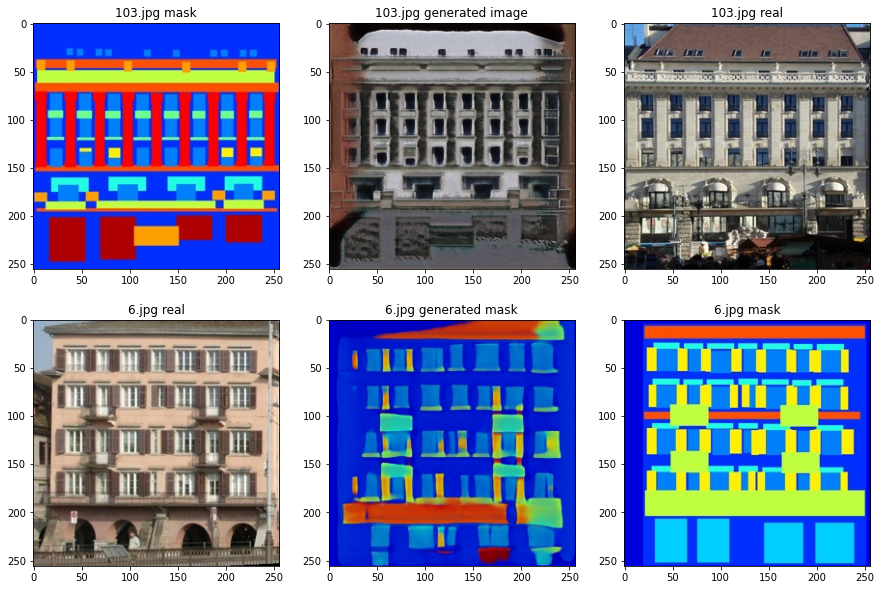

In [21]:
cycle_gan.generator_1.eval()
cycle_gan.generator_2.eval()
cnt = 0
for mask_images, real_images, mask_filenames, real_filenames, real_images_for_masks, mask_images_for_reals in test_dataloader:
    cnt += 1
    generated_images = cycle_gan.generate_image(mask_images)
    generated_masks = cycle_gan.generate_mask(real_images)
    visualize_for_cg(mask_images, generated_images, real_images, generated_masks, mask_filenames, real_filenames, real_images_for_masks, mask_images_for_reals)
    if cnt > 20:
        break